# 0.0. Imports

In [1]:
import optuna
import warnings
import pandas            as pd
import numpy             as np
import lightgbm          as lgb
import seaborn           as sns
import matplotlib.pyplot as plt

from sklearn.decomposition   import PCA
from IPython.display         import HTML
from sklearn.manifold        import TSNE
from sklearn                 import metrics

from sklearn.preprocessing   import RobustScaler
from sklearn.preprocessing   import MinMaxScaler
from sklearn.preprocessing   import LabelEncoder
from sklearn.decomposition   import TruncatedSVD
from xgboost                 import XGBClassifier
from dataprep.eda            import create_report
from sklearn.model_selection import train_test_split
from sklearn.metrics         import confusion_matrix
from sklearn.ensemble        import ExtraTreesClassifier
from sklearn.ensemble        import RandomForestClassifier



warnings.filterwarnings('ignore')

## 0.1. Helper Functions


In [2]:
def jupyter_settings():
    %matplotlib inline
    
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    display( HTML( '<style>.container { width:100% !important; }</style>') )


    sns.set()
    
jupyter_settings()

In [74]:
def preprocessing( X_train, X_test, y_train ):
    
    ###### Fill NA
    
    X_train['Nacionalidade'] = X_train['Nacionalidade'].fillna('Spain')
    X_train['Número de hospedes'] = X_train['Número de hospedes'].fillna(int(X_train['Número de hospedes'].mode()))
    
    X_test['Nacionalidade'] = X_test['Nacionalidade'].fillna('Spain')
    X_test['Número de hospedes'] = X_test['Número de hospedes'].fillna(int(X_test['Número de hospedes'].mode()))
    
    
    ###### Change dtypes
    X_train['Número de hospedes'] = X_train['Número de hospedes'].astype('int32')
    X_train['Número de hospedes'] = X_train['Número de hospedes'].apply(lambda x: 8 if x > 5 else x)

    X_test['Número de hospedes'] = X_test['Número de hospedes'].astype('int32')
    X_test['Número de hospedes'] = X_test['Número de hospedes'].apply(lambda x: 8 if x > 5 else x)      
    
    ###### Rescaling
#     rs_meses_reserva_checkin = RobustScaler()
#     X_train['Meses da reserva até o check-in'] = rs_meses_reserva_checkin.fit_transform(X_train[['Meses da reserva até o check-in']]) 
#     X_test['Meses da reserva até o check-in'] = rs_meses_reserva_checkin.transform(X_test[['Meses da reserva até o check-in']]) 
    
#     rs_numero_pernoites = RobustScaler()
#     X_train['Número de pernoites reservadas'] = rs_numero_pernoites.fit_transform(X_train[['Número de pernoites reservadas']]) 
#     X_test['Número de pernoites reservadas'] = rs_numero_pernoites.transform(X_test[['Número de pernoites reservadas']]) 

    ###### Data filtering 
    
    # Número de pernoites
    X_train['Número de pernoites reservadas'] = X_train['Número de pernoites reservadas'].apply(lambda x: 21 if x > 21 else x)

    # Número de hóspedes
    X_train['Número de hospedes'] = X_train['Número de hospedes'].apply(lambda x: 5 if x > 5 else x)
    
    ###### Encoding

    # Classificação do hotel
    X_train['Classificação do hotel'] = X_train['Classificação do hotel'].apply(lambda x: int(x.replace(' estrelas','')))
    X_test['Classificação do hotel'] = X_test['Classificação do hotel'].apply(lambda x: int(x.replace(' estrelas','')))
    
    # Regime de alimentação
    dicio_alimentacao = {'Sem refeicao':0,'Café da manha': 1,'Café da manha e jantar': 2,'Café da manha, almoco e jantar': 3}

    X_train['Regime de alimentação'] = X_train['Regime de alimentação'].apply(lambda x: dicio_alimentacao[x])
    X_test['Regime de alimentação'] = X_test['Regime de alimentação'].apply(lambda x: dicio_alimentacao[x])

    # Nacionalidade
    X_train['Nacionalidade'] = X_train['Nacionalidade'].apply(lambda x: 1 if x == "Spain" else 0)
    X_test['Nacionalidade']  = X_test['Nacionalidade'].apply(lambda x: 1 if x == "Spain" else 0)    
    
#     frequency_nationality = X_train.groupby('Nacionalidade').size() / len( data )
#     X_train['Nacionalidade'] = X_train['Nacionalidade'].apply(lambda x: frequency_nationality[x])
    
#     frequency_nationality = X_test.groupby('Nacionalidade').size() / len( data )
#     X_test['Nacionalidade'] = X_test['Nacionalidade'].apply(lambda x: frequency_nationality[x])
    

    # Já se hospedou anterioremente
    X_train['Já se hospedou anterioremente'] = X_train['Já se hospedou anterioremente'].apply(lambda x: 0 if x == "Não" else 1)
    X_test['Já se hospedou anterioremente'] = X_test['Já se hospedou anterioremente'].apply(lambda x: 0 if x == "Não" else 1)
    
    # Tipo do quarto reservado
    tipo_quarto = { 'Amethyst':1,
                    'Green Emerald':8,
                    'Pink Sapphire':7,
                    'Tanzanite':3,
                    'Topaz':0,
                    'Blue Sapphire':9,
                    'Red Ruby':5,
                    'Peridot':2,
                    'Garnet':6,
                    'Moonstone':4}

    X_train['Tipo do quarto reservado'] = X_train['Tipo do quarto reservado'].apply(lambda x: tipo_quarto[x])
    X_test['Tipo do quarto reservado']  = X_test ['Tipo do quarto reservado'].apply(lambda x: tipo_quarto[x])
    
    # Reserva com Observações
    X_train['Reserva com Observações'] = X_train['Reserva com Observações'].apply(lambda x: 0 if x == "Nenhuma" else 1 if x == "1 a 3" else 2)
    X_test['Reserva com Observações']  = X_test ['Reserva com Observações'].apply(lambda x: 0 if x == "Nenhuma" else 1 if x == "1 a 3" else 2)
    
    # Reserva com Estacionamento
    X_train['Reserva com Estacionamento'] = X_train['Reserva com Estacionamento'].apply(lambda x: 0 if x == "Não" else 1)
    X_test ['Reserva com Estacionamento'] = X_test ['Reserva com Estacionamento'].apply(lambda x: 0 if x == "Não" else 1)
    
    # Reserva feita por agência de turismo
    X_train['Reserva feita por agência de turismo'] = X_train['Reserva feita por agência de turismo'].apply(lambda x: 0 if x == "Não" else 1)
    X_test ['Reserva feita por agência de turismo'] = X_test ['Reserva feita por agência de turismo'].apply(lambda x: 0 if x == "Não" else 1)
    
    # Reserva feita por empresa
    X_train['Reserva feita por empresa'] = X_train['Reserva feita por empresa'].apply(lambda x: 0 if x == "Não" else 1)
    X_test ['Reserva feita por empresa'] = X_test['Reserva feita por empresa'].apply(lambda x: 0 if x == "Não" else 1)
    
    # Forma de Reserva
    X_train = pd.get_dummies( X_train, prefix=['reserva'], columns=['Forma de Reserva'] )
    X_test = pd.get_dummies( X_test, prefix=['reserva'], columns=['Forma de Reserva'] )
    
    ##### Feature Engineering
    X_train, X_test, y_train = embedding_svd(X_train, X_test, y_train)
    
    ##### Feature selection
    X_train = X_train.drop(['id', 'Reserva feita por empresa','Reserva feita por agência de turismo','Classificação do hotel', 'Regime de alimentação'], axis = 1)
    X_test = X_test.drop(['id', 'Reserva feita por empresa','Reserva feita por agência de turismo','Classificação do hotel', 'Regime de alimentação' ], axis = 1)

    
    return X_train, X_test

In [59]:
def embedding(X_train, X_test, y_train):
    ###### Feature Engineering

    # Tree Based embedding

    # Model definition
    rf_model_emb = RandomForestClassifier( n_estimators = 100, random_state = 42 )

    # Model training
    rf_model_emb.fit( X_train, y_train )

    # Leaf
    df_leaf_emb = pd.DataFrame( rf_model_emb.apply( X_train ) )

    reducer_emb = PCA(n_components = 2, random_state = 42)

    embedding = reducer_emb.fit_transform( df_leaf_emb )

    # embedding
    df_leaf_emb['embedding_x'] = embedding[: , 0]
    df_leaf_emb['embedding_y'] = embedding[: , 1]

    df_leaf_emb['Reserva Cancelada'] = y_train

    X_train['embedding_x'] = embedding[: , 0]
    X_train['embedding_y'] = embedding[: , 1]
    
    X_test_leaf = pd.DataFrame( rf_model_emb.apply( X_test ) )   
    
    embedding_prep = reducer_emb.transform(X_test_leaf)
    
    X_test['embedding_x'] = embedding_prep[: , 0]
    X_test['embedding_y'] = embedding_prep[: , 1] 
    
    return X_train, X_test, y_train

In [60]:
def embedding_tsne(X_train, X_test, y_train):
    ###### Feature Engineering

    # Tree Based embedding

    # Model definition
    rf_model_emb = RandomForestClassifier( n_estimators = 100, random_state = 42 )

    # Model training
    rf_model_emb.fit( X_train, y_train )

    # Leaf
    df_leaf_emb = pd.DataFrame( rf_model_emb.apply( X_train ) )

    reducer_emb = TSNE( n_components = 3, random_state = 42, n_jobs = -1 )

    embedding = reducer_emb.fit_transform( df_leaf_emb )

    # embedding
    df_leaf_emb['embedding_x'] = embedding[: , 0]
    df_leaf_emb['embedding_y'] = embedding[: , 1]
    df_leaf_emb['embedding_z'] = embedding[: , 2]
    
    df_leaf_emb['Reserva Cancelada'] = y_train

    X_train['embedding_x'] = embedding[: , 0]
    X_train['embedding_y'] = embedding[: , 1]
    X_train['embedding_z'] = embedding[: , 2]
    
    X_test_leaf = pd.DataFrame( rf_model_emb.apply( X_test ) )   
    
    embedding_prep = reducer_emb.transform(X_test_leaf)
    
    X_test['embedding_x'] = embedding_prep[: , 0]
    X_test['embedding_y'] = embedding_prep[: , 1] 
    X_test['embedding_z'] = embedding_prep[: , 2]
    
    return X_train, X_test, y_train

In [61]:
def embedding_svd(X_train, X_test, y_train):
    ###### Feature Engineering

    # Tree Based embedding

    # Model definition
    rf_model_emb = RandomForestClassifier( n_estimators = 100, random_state = 42 )

    # Model training
    rf_model_emb.fit( X_train, y_train )

    # Leaf
    df_leaf_emb = pd.DataFrame( rf_model_emb.apply( X_train ) )

    reducer_emb = TruncatedSVD( n_components = 3, random_state = 42 )

    embedding = reducer_emb.fit_transform( df_leaf_emb )

    # embedding
    df_leaf_emb['embedding_x'] = embedding[: , 0]
    df_leaf_emb['embedding_y'] = embedding[: , 1]
    df_leaf_emb['embedding_z'] = embedding[: , 2]

    df_leaf_emb['Reserva Cancelada'] = y_train

    X_train['embedding_x'] = embedding[: , 0]
    X_train['embedding_y'] = embedding[: , 1]
    X_train['embedding_z'] = embedding[: , 2]
    
    X_test_leaf = pd.DataFrame( rf_model_emb.apply( X_test ) )   
    
    embedding_prep = reducer_emb.transform(X_test_leaf)
    
    X_test['embedding_x'] = embedding_prep[: , 0]
    X_test['embedding_y'] = embedding_prep[: , 1]
    X_test['embedding_z'] = embedding_prep[: , 2]
    
    return X_train, X_test, y_train

In [62]:
def plot_barras_empilhadas(data_barras_emp, variavel_barras_emp, target_barras_emp, figsize = (6,4)):

    aux_barras_emp  = data_barras_emp[[variavel_barras_emp, target_barras_emp]]
    aux1_barras_emp = aux_barras_emp.groupby(variavel_barras_emp).count().reset_index()
    aux1_barras_emp[target_barras_emp] = 1
    aux2_barras_emp = pd.DataFrame(aux_barras_emp.value_counts([variavel_barras_emp, target_barras_emp])).reset_index().sort_values(target_barras_emp)
    aux3_barras_emp = pd.DataFrame(aux2_barras_emp.groupby(variavel_barras_emp).sum()[0]).reset_index()
    aux3_barras_emp = pd.merge(aux2_barras_emp, aux3_barras_emp, how = 'left', on = variavel_barras_emp)
    aux3_barras_emp['percentage'] = aux3_barras_emp['0_x'] / aux3_barras_emp['0_y']
    aux3_barras_emp = aux3_barras_emp.sort_values('percentage')

    plt.figure(figsize = figsize)
    
    bar1 = sns.barplot(x = variavel_barras_emp, y = target_barras_emp, data =  aux1_barras_emp, color = 'darkblue', errorbar =  None)
    bar2 = sns.barplot(x = variavel_barras_emp, y = 'percentage', data = aux3_barras_emp[aux3_barras_emp[target_barras_emp] == 1], color = 'lightblue', errorbar =  None)

## 0.2. Loading Data

In [63]:
data = pd.read_csv('../data/train.csv')
test_data = pd.read_csv('../data/test.csv')

In [ ]:
data.head()

# 1.0. Data Description

In [97]:
data1 = data.copy()

## 1.1. Columns Description

## 1.2. Data Dimensions

In [ ]:
data1.shape

## 1.3. Data Types

In [ ]:
data1.dtypes

## 1.4. Check NA

In [98]:
data1.isna().sum()

id                                         0
Classificação do hotel                     0
Meses da reserva até o check-in            0
Número de pernoites reservadas             0
Número de hospedes                         3
Regime de alimentação                      0
Nacionalidade                           1093
Forma de Reserva                           0
Já se hospedou anterioremente              0
Tipo do quarto reservado                   0
Reserva feita por agência de turismo       0
Reserva feita por empresa                  0
Reserva com Estacionamento                 0
Reserva com Observações                    0
Reserva Cancelada                          0
dtype: int64

### 1.4.1. Fillout NA

In [99]:
data1['Nacionalidade'] = data1['Nacionalidade'].fillna('Spain')
data1['Número de hospedes'] = data1['Número de hospedes'].fillna(int(data1['Número de hospedes'].mode()))

## 1.5. Descriptive Statistics

### 1.5.1. Cotinuous Variables

In [ ]:
data1.describe()

### 1.5.2. Categorical Variables

In [ ]:
data1.columns

In [ ]:
data1['Classificação do hotel'].value_counts()

In [ ]:
data1['Regime de alimentação'].value_counts()

In [ ]:
data1['Nacionalidade'].value_counts()

In [ ]:
data1['Forma de Reserva'].value_counts()

In [ ]:
data1['Reserva com Estacionamento'].value_counts()

In [ ]:
data1['Reserva com Observações'].value_counts()

In [ ]:
data1['Reserva Cancelada'].value_counts()

## 1.6. Check Duplicates

In [100]:
data1[data1.duplicated() == True]

,id,Classificação do hotel,Meses da reserva até o check-in,Número de pernoites reservadas,Número de hospedes,Regime de alimentação,Nacionalidade,Forma de Reserva,Já se hospedou anterioremente,Tipo do quarto reservado,Reserva feita por agência de turismo,Reserva feita por empresa,Reserva com Estacionamento,Reserva com Observações,Reserva Cancelada


# 2.0. Feature Engineering

In [101]:
data2 = data1.copy()

## 2.1. Embedding

In [102]:
y_emb = data['Reserva Cancelada']
X_emb = data.drop('Reserva Cancelada', axis = 1)
X_emb_1 = data.drop('Reserva Cancelada', axis = 1)


X_emb,_  = preprocessing( X_emb, X_emb_1, y_emb )

In [103]:
# Tree Based embedding

# Model definition
# Define Weights
weights_emb = data2['Reserva Cancelada'].value_counts(normalize = True).values
weights_emb = {0: weights_emb[1], 1: weights_emb[0]}

rf_model_emb = RandomForestClassifier( n_estimators = 100, random_state = 42, class_weight = weights_emb )

# Model training
rf_model_emb.fit( X_emb, y_emb )

# Leaf
df_leaf_emb = pd.DataFrame( rf_model_emb.apply( X_emb ) )

In [ ]:
# PCA
reducer_emb = PCA(n_components = 2, random_state = 42)

embedding = reducer_emb.fit_transform( df_leaf_emb )

# embedding
df_leaf_emb['embedding_x'] = embedding[: , 0]
df_leaf_emb['embedding_y'] = embedding[: , 1]

df_leaf_emb['Reserva Cancelada'] = data['Reserva Cancelada']

data2['embedding_x'] = embedding[: , 0]
data2['embedding_y'] = embedding[: , 1]

# Plot leaves
plt.figure(figsize=(6, 6))
sns.scatterplot( x = 'embedding_x', y = 'embedding_y',
                 data = df_leaf_emb,
                 hue = 'Reserva Cancelada');

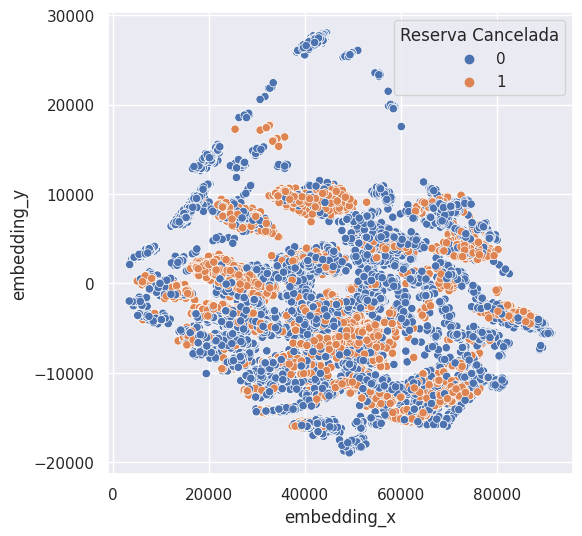

In [104]:
# SVD
reducer_emb = TruncatedSVD(n_components = 2, random_state = 42)

embedding = reducer_emb.fit_transform( df_leaf_emb )

# embedding
df_leaf_emb['embedding_x'] = embedding[: , 0]
df_leaf_emb['embedding_y'] = embedding[: , 1]

df_leaf_emb['Reserva Cancelada'] = data['Reserva Cancelada']

data2['embedding_x'] = embedding[: , 0]
data2['embedding_y'] = embedding[: , 1]

# Plot leaves
plt.figure(figsize=(6, 6))
sns.scatterplot( x = 'embedding_x', y = 'embedding_y',
                 data = df_leaf_emb,
                 hue = 'Reserva Cancelada');

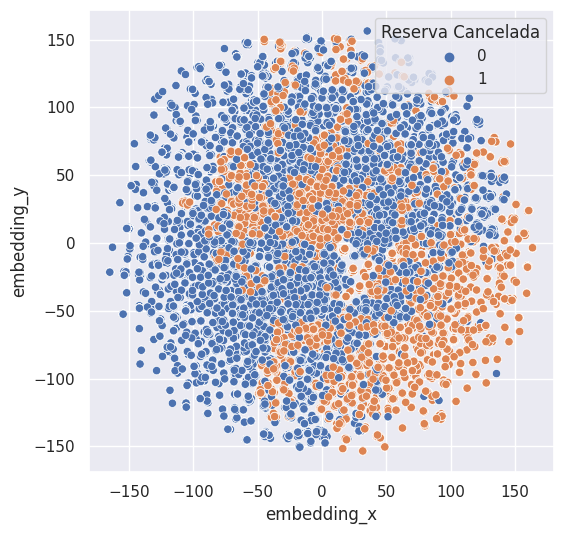

In [51]:
# embedding
df_leaf_emb['embedding_x'] = embedding[: , 0]
df_leaf_emb['embedding_y'] = embedding[: , 1]

df_leaf_emb['Reserva Cancelada'] = data['Reserva Cancelada']

data2['embedding_x'] = embedding[: , 0]
data2['embedding_y'] = embedding[: , 1]

# Plot leaves
plt.figure(figsize=(6, 6))
sns.scatterplot( x = 'embedding_x', y = 'embedding_y',
                 data = df_leaf_emb,
                 hue = 'Reserva Cancelada');

# 3.0. Data Filtering

In [23]:
data3 = data2.copy()

NameError: name 'data2' is not defined

In [106]:
data3.columns

Index(['id', 'Classificação do hotel', 'Meses da reserva até o check-in',
       'Número de pernoites reservadas', 'Número de hospedes',
       'Regime de alimentação', 'Nacionalidade', 'Forma de Reserva',
       'Já se hospedou anterioremente', 'Tipo do quarto reservado',
       'Reserva feita por agência de turismo', 'Reserva feita por empresa',
       'Reserva com Estacionamento', 'Reserva com Observações',
       'Reserva Cancelada', 'embedding_x', 'embedding_y'],
      dtype='object')

In [107]:
# Número de pernoites
data3['Número de pernoites reservadas'] = data3['Número de pernoites reservadas'].apply(lambda x: 21 if x > 21 else x)

In [108]:
# Número de hóspedes
data3['Número de hospedes'] = data3['Número de hospedes'].apply(lambda x: 5 if x > 5 else x)

# 4.0. Exploratory Data Analysis

In [111]:
data4 = data3.copy()

## 4.1. Univariate Analysis

  0%|                                                                                                         …


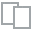
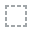
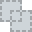
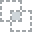
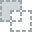
...
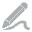
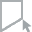
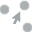
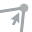
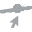

In [112]:
report = create_report(data4).show()

## 4.2. Bivatiate Analysis

### 4.2.1. Response Variable Relationship Analysis

### 4.2.2. Other Variable Relationship Analysis

## 4.3. Multivariate Analysis

# 5.0. Data Preparation

In [122]:
data5 = data4.copy()

In [123]:
data5['Número de hospedes'] = data5['Número de hospedes'].astype('int32')
data5['Número de hospedes'] = data5['Número de hospedes'].apply(lambda x: 8 if x > 5 else x)

## 5.1. Standardization

## 5.2. Rescaling

In [124]:
rs_embedding_x = MinMaxScaler()
data5['embedding_x'] = rs_embedding_x.fit_transform(data5[['embedding_x']]) 

rs_embedding_y = MinMaxScaler()
data5['embedding_y'] = rs_embedding_y.fit_transform(data5[['embedding_y']]) 

## 5.3. Encoding

In [ ]:
# Classificação do hotel
data5['Classificação do hotel'] = data5['Classificação do hotel'].apply(lambda x: int(x.replace(' estrelas','')))

In [ ]:
# Regime de alimentação

data5['Regime de alimentação'].value_counts()
dicio_alimentacao = {'Sem refeicao':0,'Café da manha': 1,'Café da manha e jantar': 2,'Café da manha, almoco e jantar': 3}

data5['Regime de alimentação'] = data5['Regime de alimentação'].apply(lambda x: dicio_alimentacao[x])

In [ ]:
# Nacionalidade
data5['Nacionalidade'] = data5['Nacionalidade'].apply(lambda x: 1 if x == "Spain" else 0)

# frequency_nationality = data5.groupby('Nacionalidade').size() / len( data )
# data5['Nacionalidade'] = data5['Nacionalidade'].apply(lambda x: frequency_nationality[x])

In [ ]:
# Já se hospedou anterioremente
data5['Já se hospedou anterioremente'] = data5['Já se hospedou anterioremente'].apply(lambda x: 0 if x == "Não" else 1)

In [ ]:
# Tipo do quarto reservado
data5['Tipo do quarto reservado'].value_counts()

tipo_quarto = { 'Amethyst':0,
                'Green Emerald':1,
                'Pink Sapphire':2,
                'Tanzanite':3,
                'Topaz':4,
                'Blue Sapphire':5,
                'Red Ruby':6,
                'Peridot':7,
                'Garnet':8,
                'Moonstone':9}

data5['Tipo do quarto reservado'] = data5['Tipo do quarto reservado'].apply(lambda x: tipo_quarto[x])

In [ ]:
# Reserva com Observações
data5['Reserva com Observações'] = data5['Reserva com Observações'].apply(lambda x: 0 if x == "Nenhuma" else 1 if x == "1 a 3" else 2)

In [ ]:
# Reserva com Estacionamento
data5['Reserva com Estacionamento'] = data5['Reserva com Estacionamento'].apply(lambda x: 0 if x == "Não" else 1)

In [ ]:
# Reserva feita por agência de turismo
data5['Reserva feita por agência de turismo'] = data5['Reserva feita por agência de turismo'].apply(lambda x: 0 if x == "Não" else 1)

In [ ]:
# Reserva feita por empresa
data5['Reserva feita por empresa'] = data5['Reserva feita por empresa'].apply(lambda x: 0 if x == "Não" else 1)

In [ ]:
# Forma de Reserva
data5 = pd.get_dummies( data5, prefix=['reserva'], columns=['Forma de Reserva'] )

# 6.0. Feature Selection

In [ ]:
data6 = data5.copy()

## 6.1. Manual Feature Selection

In [ ]:
data6.columns

In [ ]:
data6 = data6.drop(['id', 'Reserva feita por empresa','Reserva feita por agência de turismo'], axis = 1)

In [ ]:
#plot_barras_empilhadas(data6,'reserva_B2B', 'Reserva Cancelada', figsize = (20,4))

## 6.2. Extra Trees Feature Selection

In [ ]:
##### Extra trees ######
y = data6['Reserva Cancelada']
X = data6.drop(['Reserva Cancelada', 'id'], axis = 1)

# Model definition
extra_trees = ExtraTreesClassifier( n_estimators = 250, n_jobs = -1 )

# Training model
extra_trees.fit( X, y )

# Get feature importances
importances = extra_trees.feature_importances_

# Load std of estimators feature importances
std_importances = np.std( [tree.feature_importances_ for tree in extra_trees.estimators_], axis = 0 )

# Sort list of feature importance
indices_importances = np.argsort( importances )[::-1]

# Print feature ranking
print('Feature Ranking: ')
df = pd.DataFrame()
for i, j in zip(X, extra_trees.feature_importances_):
    aux = pd.DataFrame( {'feature': i, 'importance': j}, index = [0])
    df = pd.concat( [ df, aux], axis = 0 )
    df = df.sort_values( 'importance', ascending = False ) 
print( df )

In [ ]:
# Plot impurity-based feature importances of the forest
plt.figure(figsize = (6, 4) )
plt.title('Feature Importances')
plt.bar( range (X.shape[1]), importances[indices_importances], 
         color = "r", yerr = std_importances[indices_importances], align = "center")
plt.xticks( range( X.shape[1]), df['feature'].values, rotation = 90 )
plt.xlim( [ -1, X.shape[1] ] )
plt.show()

## 6.3. Final feature Selection

# 7.0. Machine Learning Modelling

In [7]:
data7 = data6.copy()

NameError: name 'data6' is not defined

In [15]:
y = data['Reserva Cancelada']
X = data.drop('Reserva Cancelada', axis = 1)

In [16]:
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size = 0.2 )

X_train, X_test = preprocessing( X_train, X_test, y_train )

## 7.1. Models

### 7.1.1. XGBoost

#### 7.1.1.1. Model Definition

In [17]:
# Definição modelo
xgb_model = XGBClassifier(n_estimators = 500, max_depth = 6, random_state = 42)

# Treino
xgb_model.fit(X_train, y_train)

# Predictions
xgb_probas = xgb_model.predict_proba(X_test)
xgb_probas = xgb_probas.T[1]

In [18]:
limiares  = np.arange(0,1, 0.01)

xgb_scores = []

for limiar in limiares:
    predictions = []
    
    for proba in xgb_probas:
        if proba > limiar:
            predictions.append(1)
        else:
            predictions.append(0)
            
    f1 = metrics.f1_score(y_test, predictions)
    
    xgb_scores.append(f1)

#### 7.1.1.2. Model Evaluation

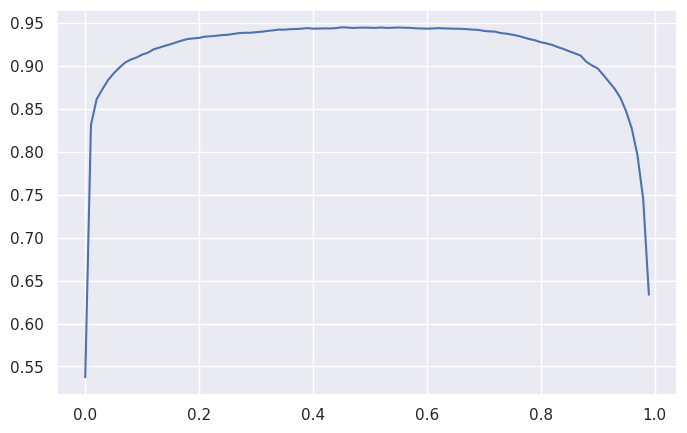

In [19]:
plt.figure(figsize = (8,5))
sns.lineplot(x = limiares, y = xgb_scores);

In [20]:
xgb_predictions = []
limiar = 0.5

for proba in xgb_probas:
    if proba > limiar:
        xgb_predictions.append(1)
    else:
        xgb_predictions.append(0)

In [21]:
confusion_matrix(y_test, xgb_predictions)

array([[8789,  340],
       [ 255, 5048]])

In [22]:
metrics.f1_score(y_test, xgb_predictions)

0.9443457113459919

#### 7.1.2.1. Model Definition

### 7.1.2. LightGBM

In [86]:
# Define model
lgbm_model = lgb.LGBMClassifier(n_estimators = 500,
                                max_depth = 6,
                                boosting_type= 'gbdt',
                                objective = 'binary',
                                metric = 'binary_logloss'
                                )

# Treino
lgbm_model.fit(X_train, y_train)

# Predictions
lgbm_probas = lgbm_model.predict_proba(X_test)
lgbm_probas = lgbm_probas.T[1]

#### 7.1.2.2. Model Evaluation

In [87]:
limiares  = np.arange(0,1, 0.01)

lgbm_scores = []

for limiar in limiares:
    predictions = []
    
    for proba in lgbm_probas:
        if proba > limiar:
            predictions.append(1)
        else:
            predictions.append(0)
            
    f1 = metrics.f1_score(y_test, predictions)
    
    lgbm_scores.append(f1)

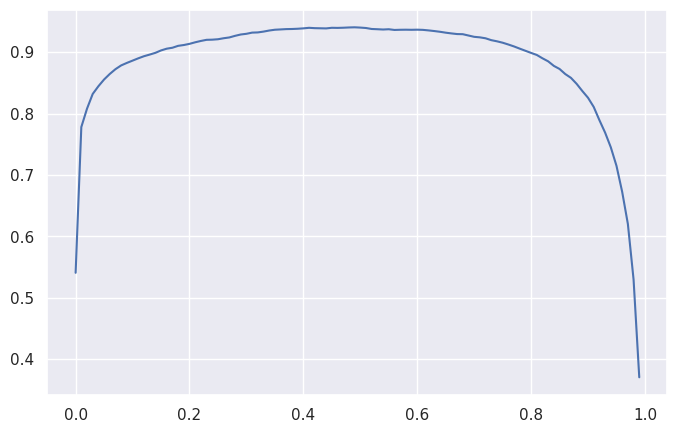

In [88]:
plt.figure(figsize = (8,5))
sns.lineplot(x = limiares, y = lgbm_scores);

In [89]:
lgbm_predictions = []
limiar = 0.56

for proba in lgbm_probas:
    if proba > limiar:
        lgbm_predictions.append(1)
    else:
        lgbm_predictions.append(0)

In [90]:
metrics.f1_score(y_test, lgbm_predictions)

0.9362466893681423

## 7.2. Comparing Models Performance

## 7.3. Selected Model

# 8.0. Hyperparameter Fine Tuning

## 8.1. Optuna

In [91]:
y = data['Reserva Cancelada']
X = data.drop('Reserva Cancelada', axis = 1)

X_train, X_test, y_train, y_test = train_test_split( X, y, test_size = 0.2 )

X_train, X_test = preprocessing( X_train, X_test, y_train )

def objective(trial):
    """Define the objective function"""

    params = {
        'boosting_type': 'gbdt',
        'objective': 'binary',
        'metric': 'binary_logloss',
        'max_depth': trial.suggest_int('max_depth', 1, 10),
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 1.0),
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'subsample': trial.suggest_loguniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_loguniform('colsample_bytree', 0.01, 1.0),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 1.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 1.0),
    }

    # Fit the model
    optuna_model = lgb.LGBMClassifier(**params)
    optuna_model.fit(X_train, y_train)

    # Make predictions
    y_pred = optuna_model.predict(X_test)
    xgb_predictions = optuna_model.predict(X_test)

    # Evaluate predictions
    f1_score = metrics.f1_score(y_test, xgb_predictions)
    
    return f1_score

# study = optuna.create_study(direction='maximize')
# study.optimize(objective, n_trials = 100, timeout = 600)

# print('Number of finished trials: {}'.format(len(study.trials)))
# print('Best trial:')
# trial = study.best_trial

# print('  Value: {}'.format(trial.value))
# print('  Params: ')

# for key, value in trial.params.items():
#      print('    {}: {}'.format(key, value))

## 8.2. Final Model

In [75]:
train_data = data.drop('Reserva Cancelada', axis = 1)
X_train, X_test = preprocessing( train_data, test_data, data['Reserva Cancelada'] )

AttributeError: 'int' object has no attribute 'replace'

In [76]:
model = XGBClassifier(n_estimators = 1000, max_depth = 10, learning_rate = 0.35140412829357376, min_child_weight = 1, subsample =  0.7435920293033955, random_state = 42)
model.fit(X_train, data['Reserva Cancelada'])

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.35140412829357376,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=10, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=1000, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=42, ...)

## 8.3. Final Predictions

In [77]:
predict_proba = model.predict_proba(X_test).T[1]
predictions = []

limiar = 0.5

for proba in predict_proba:
    if proba > limiar:
        predictions.append(1)
    else:
        predictions.append(0)

In [78]:
sumbmission_data = pd.DataFrame(test_data['id'])
sumbmission_data['Reserva Cancelada'] = predictions

## 8.4. Export Data

In [79]:
sumbmission_data.to_csv('../data/submission_18.csv', index = False)

# 9.0. Error Interpretation

## 9.1. Model Performance